# 3D - Spectra

In [1]:
# Librerías estándar y de terceros
import os
import sys
import gc
import math as m
import numpy as np
import scipy
import pandas as pd
from scipy import *
from scipy.signal import butter, filtfilt, hilbert
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.cm as cm
from scipy.interpolate import interp1d

import pylab
params = {'legend.fontsize': 'x-Large',
          'figure.figsize': (15, 6),
         'axes.labelsize': 33,
         'axes.titlesize':33,
         'xtick.labelsize':30,
         'ytick.labelsize':30,
    'font.family': 'STIXGeneral',  
    'axes.titleweight': 'normal',
    'axes.labelweight': 'normal',
    'text.usetex': True, 
}

pylab.rcParams.update(params)
sys.path.append('/projects/DEIKE/cmartinb/functions')
from prepare import load_object, save_object, field
from defs import Case, Interface2D
from phase import extract_phase
from funciones import * 

os.chdir('/projects/DEIKE/cmartinb/')

# $Re = 720$ $Bo = 200$ $akHs = 0. 16$ $u*/c = 0.50$ $Re_{w} = 1.0e5$ $MaxLevel = 10$

In [2]:
work_dir = '/projects/DEIKE/nscapin/broadband_reorder/re720_bo0200_P0p16_uoc0p50_reW1.0e5_L10/'
data = np.loadtxt(work_dir+'eta/global_int.out')

# Obtener la segunda columna
istep_c =data[:, 1] #iteration
time = data[:,0] #time

In [4]:
eta_series = np.load('eta/eta_series_re720_bo0200_P0p16_uoc0p50_reW1.0e5_L10.npy', allow_pickle=True)

In [5]:
data = eta_series
#print(eta_series[4])
kp = 4; omegap = (1*kp)**0.5

In [7]:
def spectrum3D_subdivisions(DataEta, time, ln):
    '''
    Compute 3D Fourier Transform in Space and Time over subdivisions of length ln
    in DataEta and calculate different spectra.
    
    DataEta: list with eta (2D) at different times.
    time: vector time associated with this eta.
    ln: length of subdivisions in DataEta.
    '''

    dt = time[1] - time[0]  # Sampling intervals, (s)
    T = time[-1] - time[0]  # Total duration
    
    L0 = 2 * np.pi
    N = 512  # Domain size and grid number in each direction
    
    dx = L0 / N  # Spatial sampling step along X in (m)
    dy = L0 / N  # Spatial sampling step along Y in (m)
    
    # Initialize lists to store spectra for each subdivision
    all_F_xyomega = []
    all_F_kthetaomega = []
    all_F_komega = []
    all_F_ktheta = []
    hann_window = np.hanning(ln)
    #print(dt)
    #F_xyomega = np.zeros((N, len(time), N))
    #F_kthetaomega = np.zeros((len(theta), len(time), len(k)))
    #F_komega = np.zeros((len(k),len(time)))  # Dimension k x omega
    #print('length loop', range(0, len(DataEta), ln))
    overlap_factor = 0.5
    overlap = int(ln * overlap_factor)
    # Process each subdivision of length ln
    for start_idx in range(0,len(DataEta) - overlap, ln - overlap):
        end_idx = start_idx + ln
        #Data_pad = np.pad(DataEta, 1, mode='constant')
        print('interval time idx' ,start_idx, end_idx)
        time_subdivision = np.array(time[start_idx:end_idx])
        #print('tw/Tp', omegap*(time_subdivision - time[0])/(2*np.pi))
        data_subdivision = np.array(DataEta[start_idx:end_idx])
        
        if end_idx > len(DataEta):
            # In this case, we can choose to either skip the last window or include it with padding.
            # Let's choose to skip for now.
            break
        
        for i in range(data_subdivision.shape[1]):  # Loop over the second dimension
            for j in range(data_subdivision.shape[2]):  # Loop over the third dimension
                data_subdivision[:, i, j] *= hann_window
        

        dt = time_subdivision[1] - time_subdivision[0]
        
        T = time_subdivision[-1] - time_subdivision[0] 
        x_max = dx * data_subdivision.shape[2]
        y_max = dy * data_subdivision.shape[1]
        
        # Frequencies and wavenumbers for the subdivision
        omega = 2 * np.pi * np.fft.fftshift(np.fft.fftfreq(data_subdivision.shape[0], dt))
        wavenumber = 2 * np.pi * np.fft.fftfreq(N, L0 / N)
        theta = np.linspace(0, 2 * np.pi, N)  # Assuming N points for theta as well
        kx = np.fft.fftshift(wavenumber)
        ky = kx
        k = wavenumber#[0:int(N/2)] #only k>0
        #omega = omega[int(Nt/2):] #only freq>0
        
        spectrum3D = np.fft.fftn(data_subdivision / (N**3))  # FFT normalization for the subdivision
        spectrum3D = np.fft.fftshift(spectrum3D, axes=(0, 1, 2))
        #print('spectrum shape',spectrum3D.shape)
        
        # Compute power spectrum for the subdivision
        dkx = kx[1] - kx[0]
        dky = ky[1] - ky[0]
        domega = omega[1] - omega[0] if len(omega) > 1 else omega[0]  # Handle case with single omega value
        F_3D = (np.absolute(spectrum3D))**2 / (N**2) / ln / (dkx * dky * domega**2)
        #print('intervalo', start_idx, 'F3D' , F_3D.shape)

        kx_tile, ky_tile = np.meshgrid(kx, ky)  # kx-ky space
        k_tile, theta_tile = np.meshgrid(k, theta)  # k-theta space
        kxp_tile, kyp_tile = pol2cart(k_tile, theta_tile)
        Omega, K = np.meshgrid(omega, k) # k-omega space
        
        
        F_xy_interval=[]
        F_komega_interval =[]
        F_ktheta_interval = []
        for i in range(ln):  # Loop over the frequencies (omega)
            F_xy = F_3D[i]#, 512:,:-512]  # Spectrum F(kx,ky) for each (512,512) in the interval
            #print(kx_tile.shape, ky_tile.shape,F_xy.shape, kxp_tile.shape, kyp_tile.shape )
            #F_yomega[:, i, :] = F_xy  # Each column of F_xyomega is a freq
            #F_xyomega[start_idx:start_idx+ln, :, :] = F_3D
            F_ktheta = scipy.interpolate.griddata((kx_tile.ravel(), ky_tile.ravel()), F_xy.ravel(), (kxp_tile, kyp_tile), method='nearest')  # F(omega,kx,ky) --> F(omega,k,theta) for each freq i
            dtheta = theta[1] - theta[0]
            F_komega= np.sum(F_ktheta * k_tile, axis=0) * dtheta  # Integral in theta for each freq i
            
            F_xy_interval.append(F_xy)
            F_komega_interval.append(F_komega)
            F_ktheta_interval.append(F_ktheta)
        # Append the spectra for this subdivision
        all_F_xyomega.append(F_xy_interval)
        all_F_komega.append(F_komega_interval)
        all_F_ktheta.append(F_ktheta_interval)
        
        #print('all xy omega', np.array(all_F_xyomega).shape)

    return k , omega,  k_tile, theta_tile, kx, kx_tile, ky_tile , all_F_xyomega, all_F_komega, Omega, K , all_F_ktheta, kxp_tile, kyp_tile

In [8]:
ln = 150
k , omega,  k_tile, theta_tile, kx,  kx_tile, ky_tile , all_F_xyomega, all_F_komega,  Omega, K , all_F_ktheta , kxp_tile, kyp_tile = spectrum3D_subdivisions(data, time, ln)

interval time idx 0 150
interval time idx 75 225
interval time idx 150 300
interval time idx 225 375
interval time idx 300 450
interval time idx 375 525


(5, 150, 512, 512)


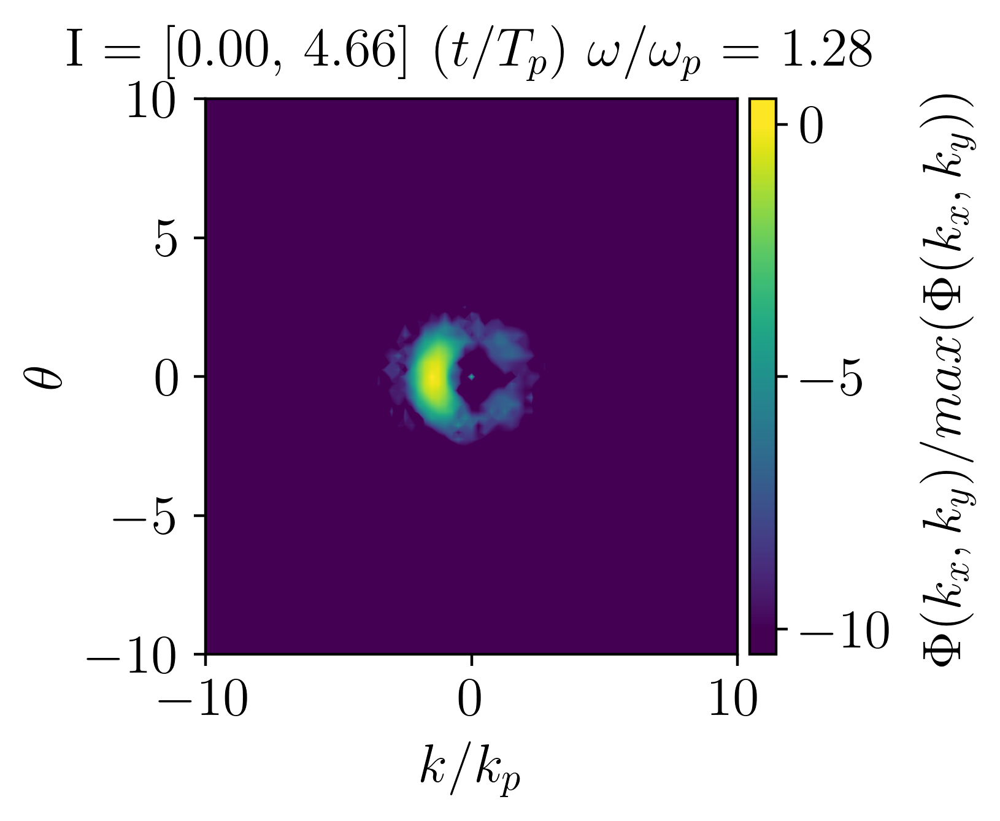

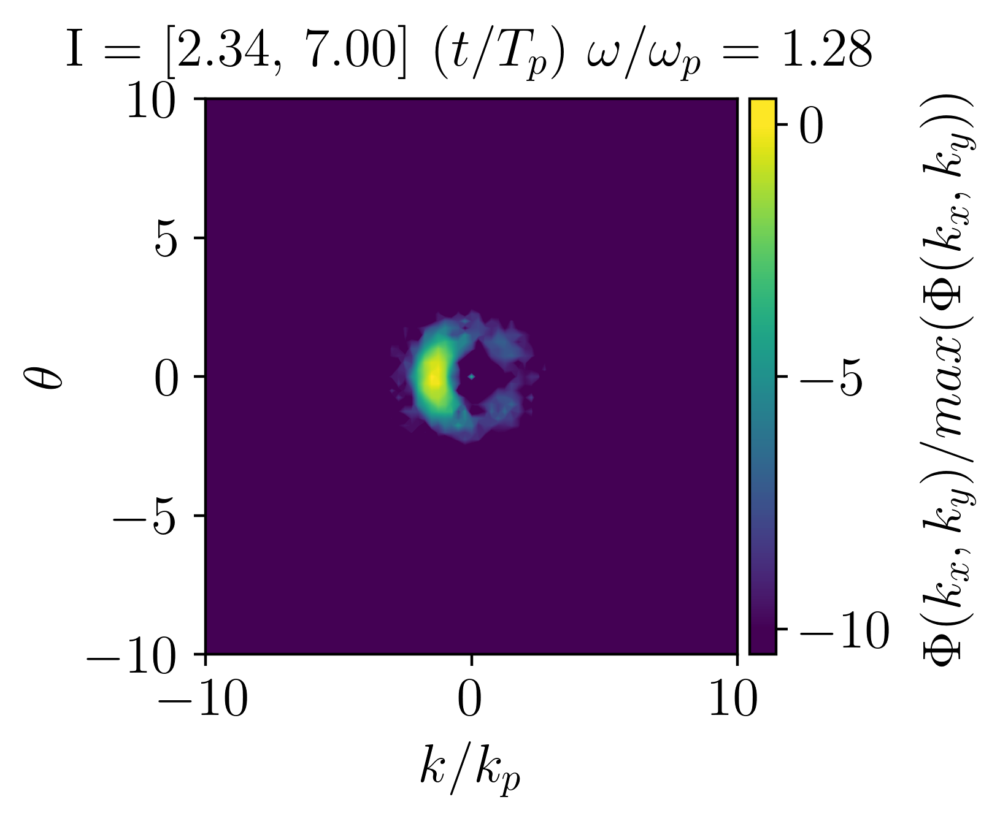

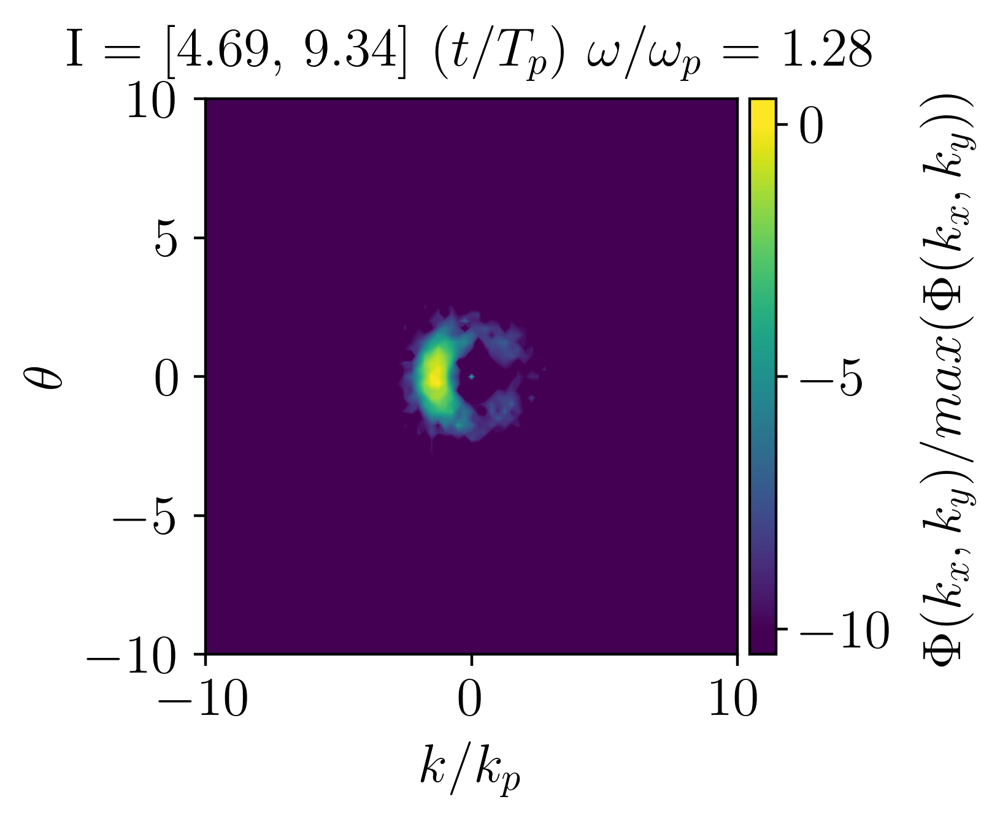

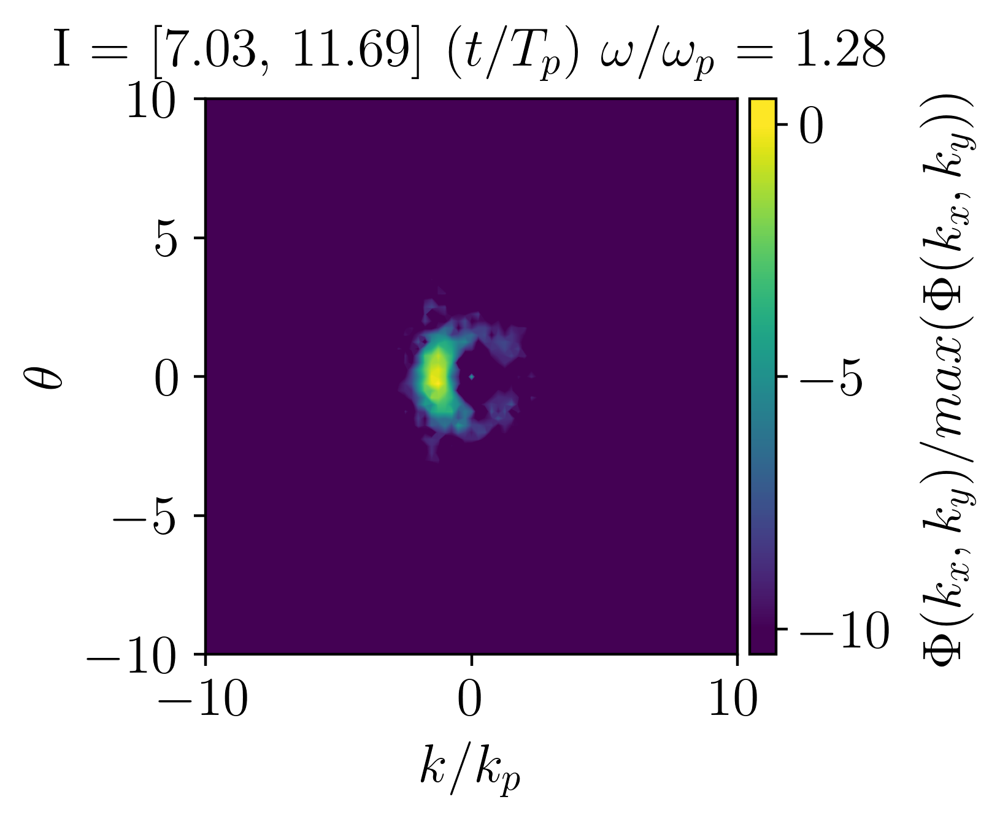

In [10]:
params = {'legend.fontsize': 'x-Large',
          'figure.figsize': (3, 3),
         'axes.labelsize': 16,
         'axes.titlesize':16,
         'xtick.labelsize':16,
         'ytick.labelsize':16}
pylab.rcParams.update(params)


colormap = cm.viridis
#normalize = plt.Normalize(vmin=0, vmax=(len(df_pivot.columns) - 2)/4)  # normalizar basado en el número de intervalos

array = np.array(all_F_xyomega) # Esto toma la primera subdivisión como ejemplo
print(array.shape)

dt = time[1] - time[0]
overlap_factor =0.5
overlap = int(ln * overlap_factor)
# Calcula la duración de cada intervalo basado en 'ln' y el intervalo de muestreo 'dt'
start_idx = 0
for i in range(array.shape[0]-1):
    fig, ax = plt.subplots(figsize=(3, 3))
    vmin = -10
    vmax = 0
    levels = np.linspace(vmin, vmax, 200)
    end_idx = start_idx + ln 
    im = plt.contourf(kx_tile/4, ky_tile/4, np.log(array[i,81,:, :] / np.max(array[i,81,:, :])), levels=levels, extend='both')
    time_subdivision = np.array(time[start_idx:end_idx])
    #print(time_subdivision- time[0])
    #print('interval time', time_subdivision - time[0])
    
    # Calculate the end index of the current interval
    end_idx = start_idx + ln
    # Ensure don't exceed the time array
    if end_idx > len(time):
        end_idx = len(time)
    time_subdivision = time[start_idx:end_idx]
    
    #plt.ylim([-10, 10])
    #plt.xlim([-10, 10])
    plt.xlabel(r'$k/k_{p}$')
    plt.ylabel(r'$\theta$')

    ax.set_title(f'I = [{(time_subdivision[0]-time[0])*omegap/(2*np.pi):.2f}, '
                 f'{(time_subdivision[-1]-time[0])*omegap/(2*np.pi):.2f}] $(t/T_{{p}})$ $\omega/\omega_p$ = {omega[81]/omegap :.2f}',pad=10)
    
    ax.set_xlim([-10, 10])
    ax.set_ylim([-10, 10])
    
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.05)
    cbar = fig.colorbar(im, cax=cax, orientation='vertical', extendrect='False', ticks=[vmin, (vmin+vmax)/2, vmax])
    cbar.set_label(r'$\Phi(k_{x},k_{y})/max(\Phi(k_{x},k_{y}))$',  labelpad=7)
    plt.show()
    
    # Update start_idx to reflect the overlapping intervals
    start_idx += (ln - overlap)
    # Break the loop if the next start_idx is beyond the array length
    if start_idx >= len(time):
        break

array shape: (5, 150, 512, 512)
(512, 512)


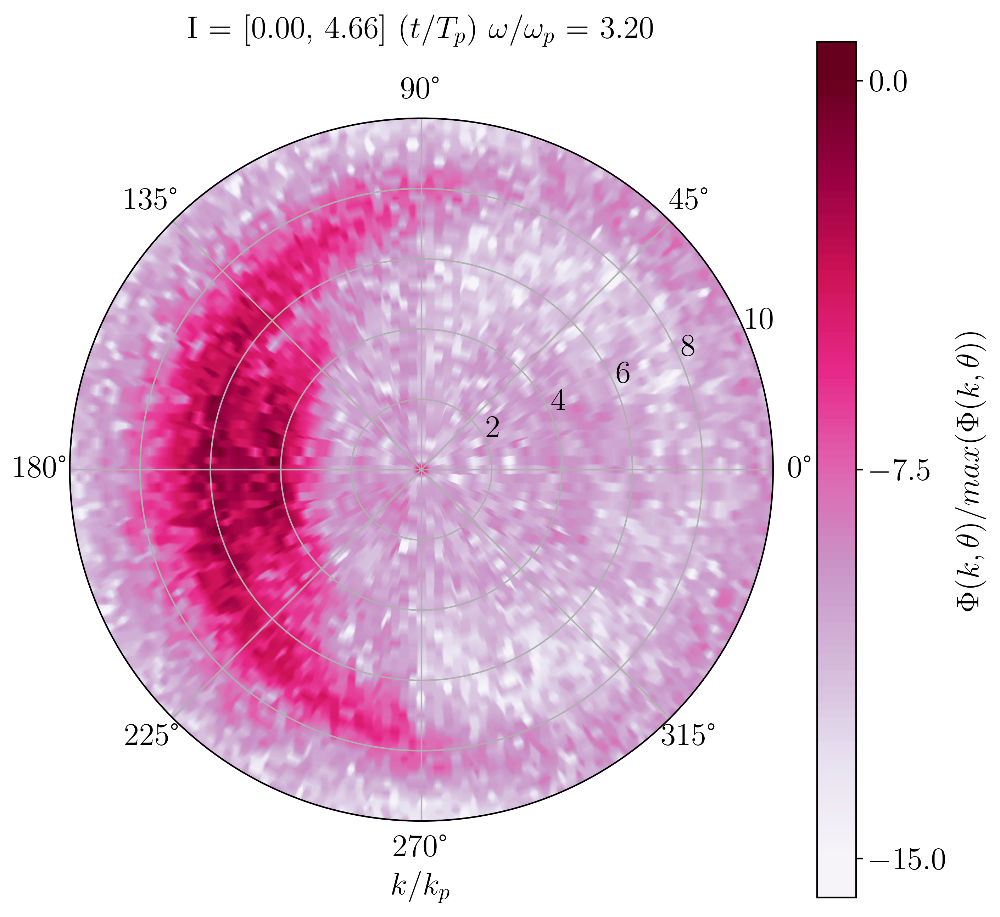

(512, 512)


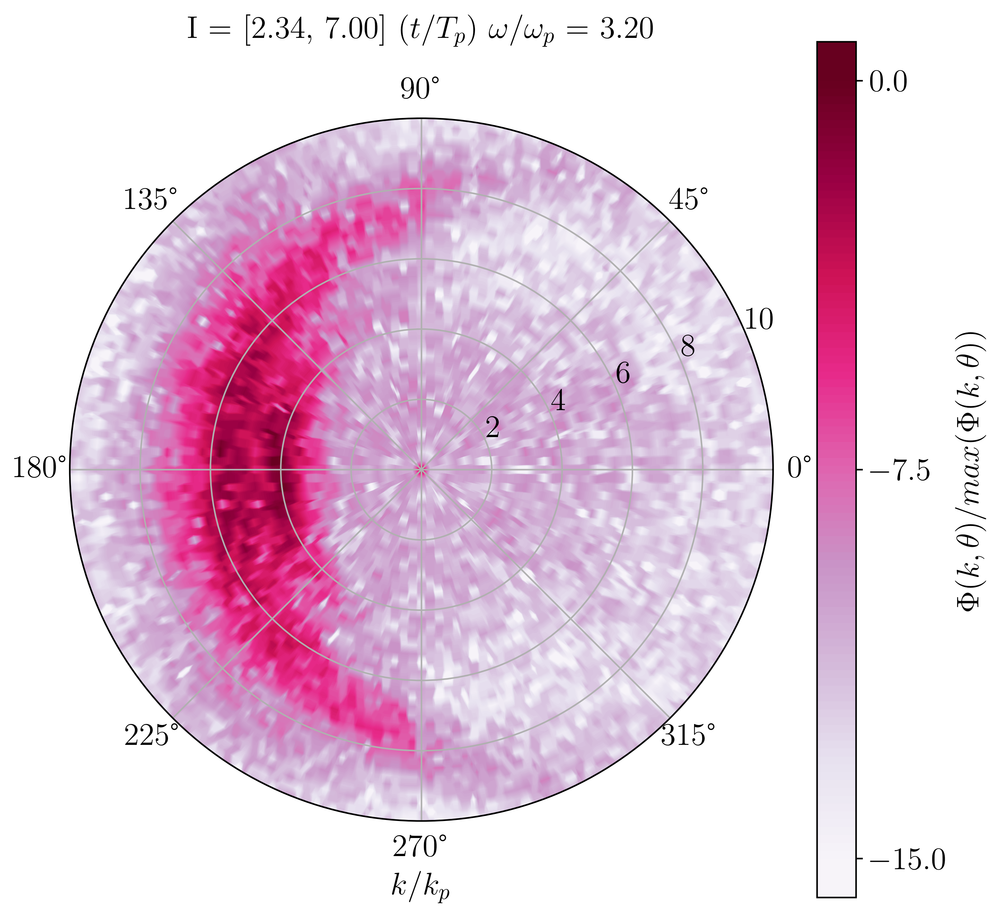

(512, 512)


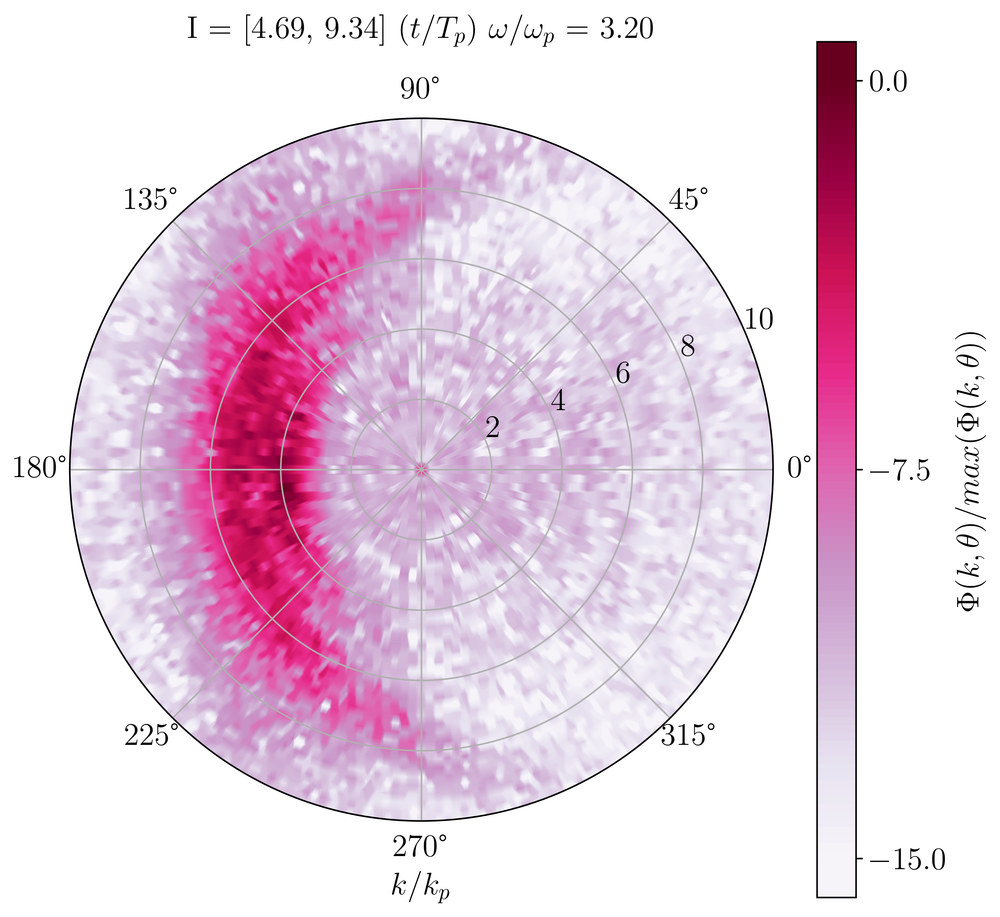

(512, 512)


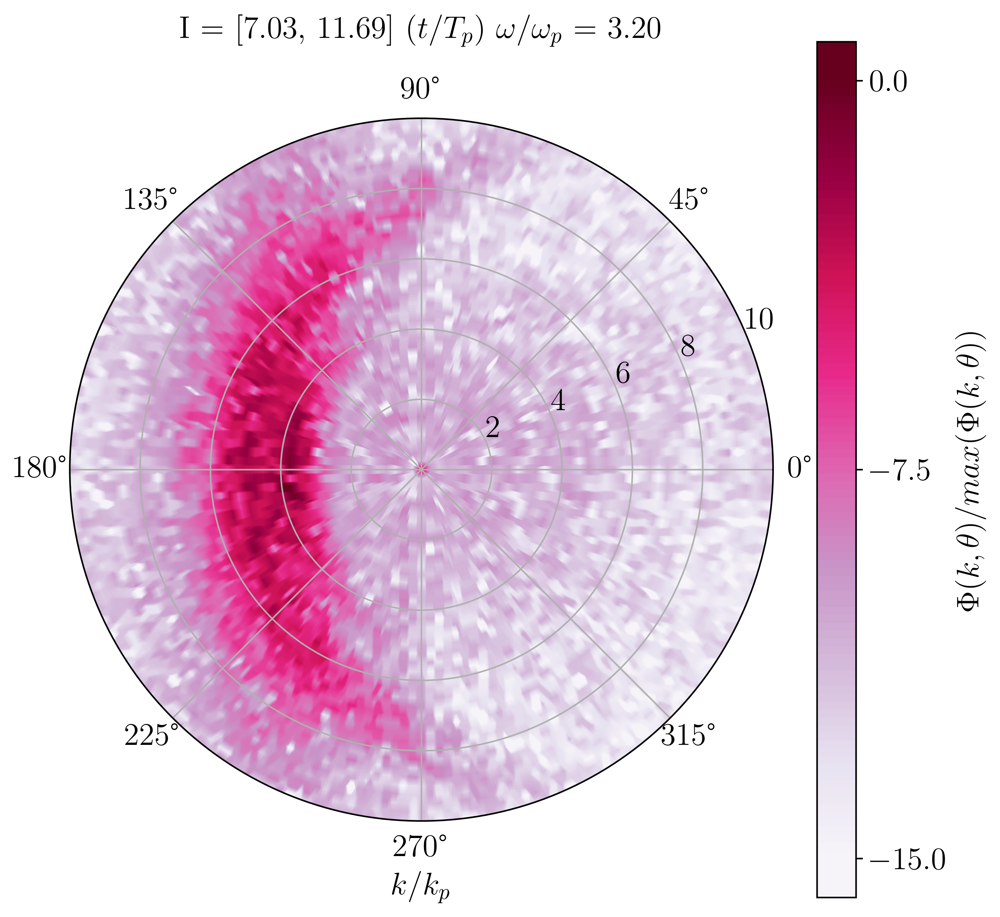

In [12]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy.ndimage import gaussian_filter


array = np.array(all_F_ktheta)
print("array shape:", array.shape)

dt = time[1] - time[0]
overlap_factor = 0.5
overlap = int(ln * overlap_factor)


start_idx = 0
for i in range(array.shape[0] - 1):
    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, polar=True)
    
    vmin = -15
    vmax = 0
    levels = np.linspace(vmin, vmax, 100)
    
    end_idx = start_idx + ln
    time_subdivision = np.array(time[start_idx:end_idx])
    #print(time_subdivision - time[0])

    Z = np.log(array[i, 90, :, :] / np.max(array[i, 90, :, :]))  # Data for contourf
    
    Z_smooth = gaussian_filter(Z.T, sigma=1)  # Transpose to match the polar coordinate system
    
    print(Z.shape)
    
    im = ax.contourf(theta_tile , k_tile/4,  Z,   extend='both', levels = levels, cmap='PuRd')
    
    plt.xlabel(r'$k/k_{p}$')
    
    ax.set_title(f'I = [{(time_subdivision[0] - time[0]) * omegap / (2 * np.pi):.2f}, '
                 f'{(time_subdivision[-1] - time[0]) * omegap / (2 * np.pi):.2f}] $(t/T_{{p}})$ $\omega/\omega_p$ = {omega[90] / omegap:.2f}', pad=20)
    ax.set_ylim(0, 10)
    # Colorbar settings
    cbar = fig.colorbar(im, ax=ax, orientation='vertical', extendrect='False', ticks=[vmin, (vmin + vmax) / 2, vmax])
    cbar.set_label(r'$\Phi(k,\theta)/max(\Phi(k,\theta))$', labelpad=3)
    
    plt.show()
    
    # Update start_idx to reflect the overlapping intervals
    start_idx += (ln - overlap)
    # Break the loop if the next start_idx is beyond the array length
    if start_idx >= len(time):
        break

/tmp/ipykernel_3977300/1851251786.py:73: RuntimeWarning: divide by zero encountered in log
  im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
/tmp/ipykernel_3977300/1851251786.py:73: RuntimeWarning: invalid value encountered in log
  im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
/tmp/ipykernel_3977300/1851251786.py:85: RuntimeWarning: invalid value encountered in true_divide
  column_data = np.log(submatrix[:, col] / np.max(submatrix[:, col]))
/tmp/ipykernel_3977300/1851251786.py:222: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k * g)


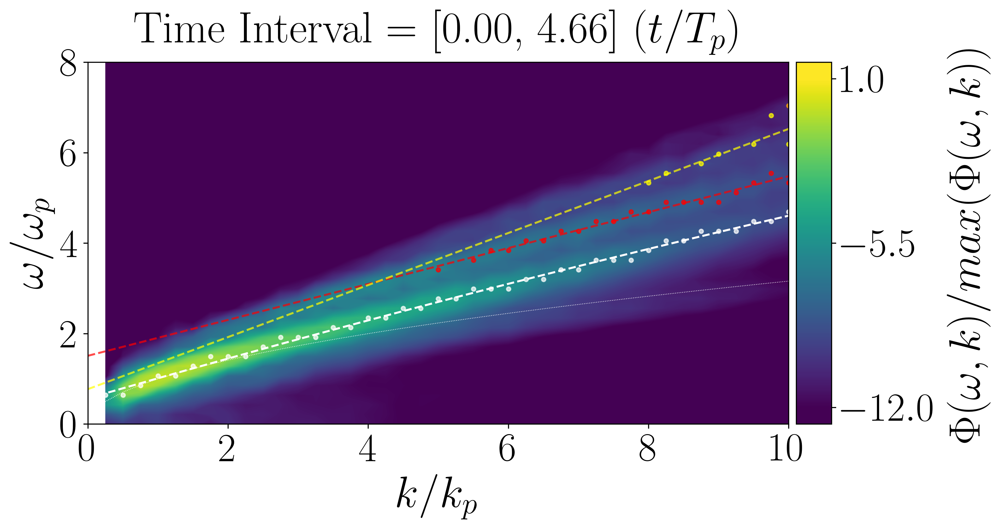

/tmp/ipykernel_3977300/1851251786.py:73: RuntimeWarning: divide by zero encountered in log
  im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
/tmp/ipykernel_3977300/1851251786.py:73: RuntimeWarning: invalid value encountered in log
  im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
/tmp/ipykernel_3977300/1851251786.py:85: RuntimeWarning: invalid value encountered in true_divide
  column_data = np.log(submatrix[:, col] / np.max(submatrix[:, col]))
/tmp/ipykernel_3977300/1851251786.py:222: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k * g)


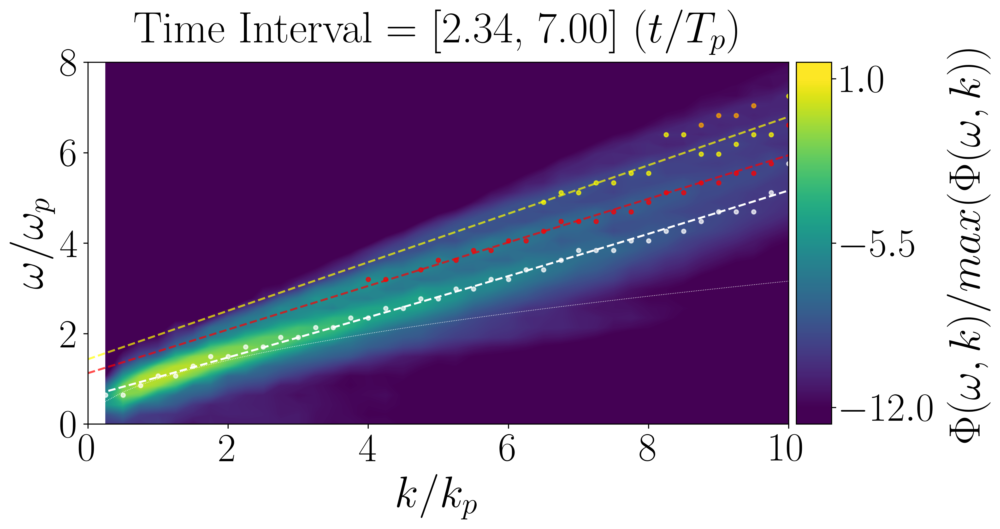

/tmp/ipykernel_3977300/1851251786.py:73: RuntimeWarning: divide by zero encountered in log
  im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
/tmp/ipykernel_3977300/1851251786.py:73: RuntimeWarning: invalid value encountered in log
  im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
/tmp/ipykernel_3977300/1851251786.py:85: RuntimeWarning: invalid value encountered in true_divide
  column_data = np.log(submatrix[:, col] / np.max(submatrix[:, col]))
/tmp/ipykernel_3977300/1851251786.py:222: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k * g)


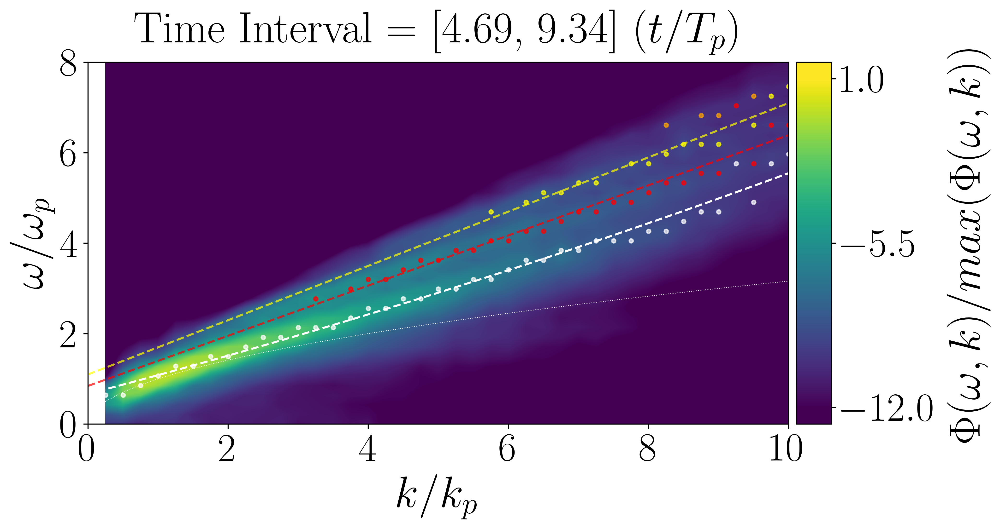

/tmp/ipykernel_3977300/1851251786.py:73: RuntimeWarning: divide by zero encountered in log
  im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
/tmp/ipykernel_3977300/1851251786.py:73: RuntimeWarning: invalid value encountered in log
  im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
/tmp/ipykernel_3977300/1851251786.py:85: RuntimeWarning: invalid value encountered in true_divide
  column_data = np.log(submatrix[:, col] / np.max(submatrix[:, col]))
/tmp/ipykernel_3977300/1851251786.py:222: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k * g)


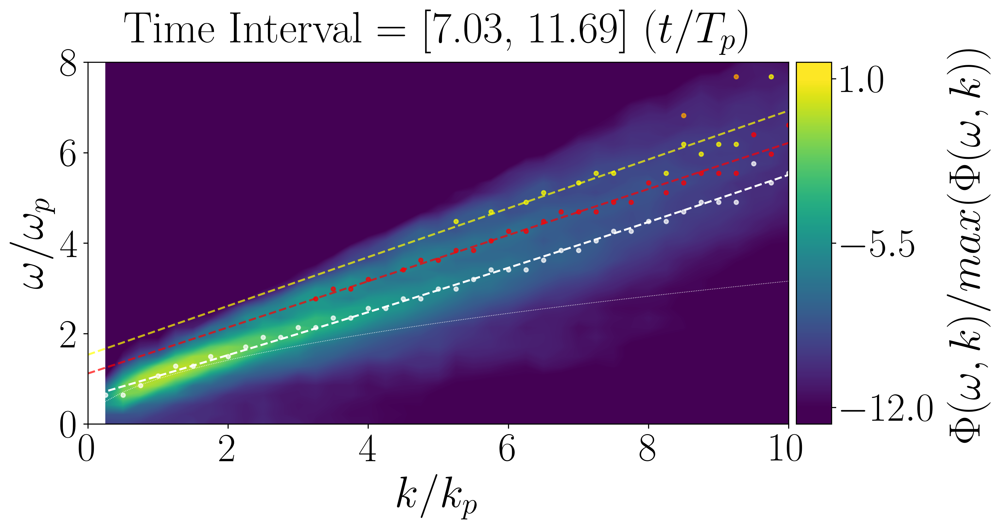

/tmp/ipykernel_3977300/1851251786.py:73: RuntimeWarning: divide by zero encountered in log
  im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
/tmp/ipykernel_3977300/1851251786.py:73: RuntimeWarning: invalid value encountered in log
  im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
/tmp/ipykernel_3977300/1851251786.py:85: RuntimeWarning: invalid value encountered in true_divide
  column_data = np.log(submatrix[:, col] / np.max(submatrix[:, col]))
/tmp/ipykernel_3977300/1851251786.py:222: RuntimeWarning: invalid value encountered in sqrt
  dispersion_relation = np.sqrt(k * g)


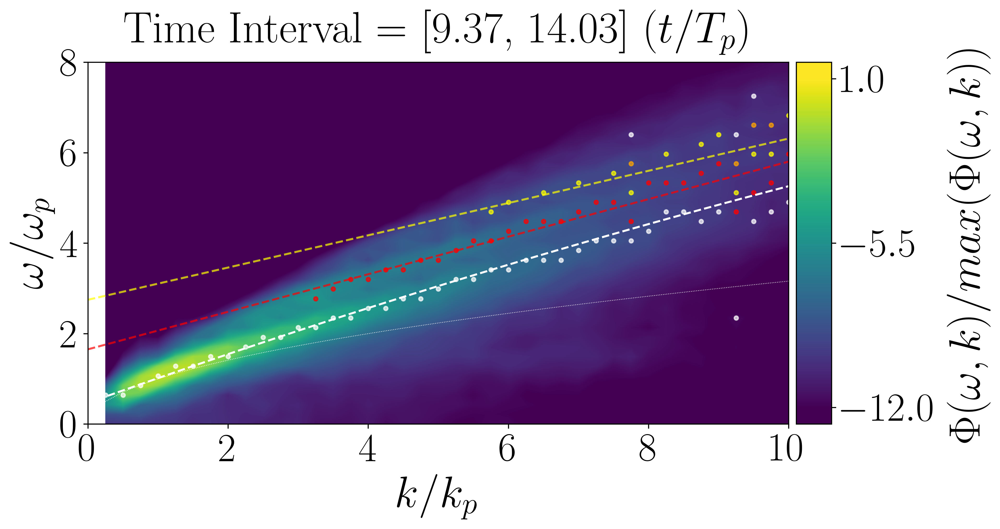

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy.signal import find_peaks
from scipy import stats

# Parámetros de la gráfica
params = {
    'legend.fontsize': 'x-Large',
    'figure.figsize': (14, 6),
    'axes.labelsize': 33,
    'axes.titlesize': 33,
    'xtick.labelsize': 30,
    'ytick.labelsize': 30,
    'font.family': 'STIXGeneral',
    'axes.titleweight': 'normal',
    'axes.labelweight': 'normal',
    'text.usetex': True,
}
plt.rcParams.update(params)

Re_water = 2.5 * 10**4
c = 1
nu_water = c * 2 * np.pi / (4 * Re_water)
g = 1
omegap = np.sqrt(g * 4)
all_F_komega = np.array(all_F_komega)
interval_duration = ln * dt
overlap_factor = 0.5
overlap = int(ln * overlap_factor)
start_idx = 0

k_min = 0
k_max = 10 * 4
omega_min = 0
omega_max = 8 * omegap

differences_first = []
k_values_first = []
omega_values_first = []
interval_indices_first = []

differences_second = []
k_values_second = []
omega_values_second =[]
interval_indices_second = []

differences_third = []
k_values_third  = []
omega_values_third = []
interval_indices_third  = []

slopes =[]

num_intervals = all_F_komega.shape[0]
for i in range(num_intervals):
    fig, ax = plt.subplots(figsize=(10, 5))
    vmin = -12
    vmax = 1
    levels = np.linspace(vmin, vmax, 300)
    end_idx = start_idx + ln
    if end_idx > len(time):
        end_idx = len(time)
    time_subdivision = time[start_idx:end_idx]
    norm = np.max(all_F_komega[i, :, :])
    
    k_indices = np.where((k >= k_min) & (k <= k_max))[0]
    omega_indices = np.where((omega >= omega_min) & (omega <= omega_max))[0]
    
    # Crear la submatriz del cuadrante
    submatrix = all_F_komega[i, :][:, k_indices][omega_indices, :]
    
    im = ax.contourf(k / 4, omega / omegap, np.log(all_F_komega[i, :, :] / norm), levels=levels, extend='both')
    

    first_peaks_k = []
    second_peaks_k = []
    third_peaks_k = []
    first_peaks_omega = []
    second_peaks_omega = []
    third_peaks_omega = []
    
    colors = ['white', 'red', 'yellow', 'orange']
    for col in range(submatrix.shape[1]):
        column_data = np.log(submatrix[:, col] / np.max(submatrix[:, col]))
        peaks, _ = find_peaks(column_data, distance=1, height=[-2, 0])
        k_peakss = k[col] * np.ones(len(omega[omega_indices][peaks]))
        
        for j, peak in enumerate(peaks):
            color = colors[j % len(colors)]  # Asignar un color diferente para cada pico
            ax.scatter(k_peakss[j] / 4, omega[omega_indices][peak] / omegap, color=color, s=9, alpha=0.7)
            
            # Agregar los picos a las listas correspondientes
            if color == 'white':
                first_peaks_k.append(k_peakss[j] / 4)
                first_peaks_omega.append(omega[omega_indices][peak] / omegap)
            elif color == 'red':
                second_peaks_k.append(k_peakss[j] / 4)
                second_peaks_omega.append(omega[omega_indices][peak] / omegap)
            elif color == 'yellow':
                third_peaks_k.append(k_peakss[j] / 4)
                third_peaks_omega.append(omega[omega_indices][peak] / omegap)
    
    # Convertir las listas de picos en arrays para facilitar su manejo
    first_peaks_k = np.array(first_peaks_k)
    first_peaks_omega = np.array(first_peaks_omega)
    
    second_peaks_k = np.array(second_peaks_k)
    second_peaks_omega = np.array(second_peaks_omega)
    
    third_peaks_k = np.array(third_peaks_k)
    third_peaks_omega = np.array(third_peaks_omega)
    
    # Interpolación de los puntos máximos
    k_fit = first_peaks_k
    omega_fit = first_peaks_omega
    
    slope_fit, intercept_fit, r_value_fit, p_value_fit, std_err_fit = stats.linregress(k_fit,omega_fit)
    
    # Interpolación de los puntos de la segunda rama
    k_fit_second = second_peaks_k
    omega_fit_second = second_peaks_omega
    
    slope_second, intercept_second, r_value_second, p_value_second, std_err_second = stats.linregress(k_fit_second,omega_fit_second)
    
    # Interpolación de los puntos de la tercera rama
    k_fit_third = third_peaks_k
    omega_fit_third = third_peaks_omega
    
    slope_third, intercept_third, r_value_third, p_value_third, std_err_third = stats.linregress(k_fit_third,omega_fit_third)
    
    slopes.append( [slope_fit, slope_second, slope_third])
    
    if len(k_fit) > 0:  # Asegurarse de que hay puntos válidos para ajustar
        if i < 5:
            # Ajuste cuadrático para los dos primeros intervalos
            p2 = np.polyfit(k_fit, omega_fit, 2)
            fit_line2 = np.polyval(p2, np.linspace(0, 10, 100))
            ax.plot(np.linspace(0, 10, 100), fit_line2, '--', c='w', label='Ajuste Cuadrático')
            
            dispersion_relation = np.sqrt(k_fit * g)
            fit_values = np.polyval(p2, k_fit)
            dispersion_fit_diff = dispersion_relation/ omegap - fit_values
            
            # Acumular las diferencias y los valores de k para los primeros intervalos
            differences_first.extend(dispersion_fit_diff)
            k_values_first.extend(k_fit)
            omega_values_first.extend(fit_values)
            interval_indices_first.extend([i] * len(dispersion_fit_diff))  # Asignar el índice del intervalo a los puntos acumulados
        else:
            # Ajuste cúbico y lineal para los dos últimos intervalos
            p3 = np.polyfit(k_fit, omega_fit, 3)
            inflexion_points = find_inflexion_point_cubic(p3)
            inflexion_point = inflexion_points[0]  # Tomar el primer punto de inflexión encontrado

            # Particionar los datos en dos ramas
            left_branch = k_fit <= inflexion_point
            right_branch = k_fit > inflexion_point
            
            # Ajuste lineal para la rama derecha
            if np.sum(right_branch) > 1:  # Asegurarse de que hay suficientes puntos para ajustar
                p1 = np.polyfit(k_fit[right_branch], omega_fit[right_branch], 1)
                fit_line1 = np.polyval(p1, np.linspace(inflexion_point, 10, 100))
                ax.plot(np.linspace(inflexion_point, 10, 100), fit_line1, '--', c='w', label='Ajuste Lineal', alpha = 0.7)
                
                inflexion_omega = np.polyval(p3, inflexion_point)
                ax.scatter(inflexion_point, inflexion_omega, marker='*', s=20, c='white', zorder=5, label='Punto de Inflexión')

                # Ajuste cúbico para la rama izquierda
                fit_line3 = np.polyval(p3, np.linspace(0, inflexion_point, 100))
                ax.plot(np.linspace(0, inflexion_point, 100), fit_line3, '--', c='w', label='Ajuste Cúbico')
                
                # Calcular la diferencia entre la relación de dispersión y el ajuste
                dispersion_relation = np.sqrt(k_fit * g)
                fit_values = np.concatenate((np.polyval(p3, k_fit[left_branch]), np.polyval(p1, k_fit[right_branch])))
                dispersion_fit_diff = dispersion_relation / omegap - fit_values
                
                print(dispersion_relation.shape, fit_values.shape)
                
                # Acumular las diferencias y los valores de k para los últimos intervalos
                differences_first.extend(dispersion_fit_diff)
                k_values_first.extend(k_fit)
                omega_values_first.extend(fit_values)
                interval_indices_first.extend([i] * len(dispersion_fit_diff))  # Asignar el índice del intervalo a los puntos acumulados

    # Ajuste para los puntos de la segunda rama
    
    if len(k_fit_second) > 0:
        p_red = np.polyfit(k_fit_second, omega_fit_second, 1)
        fit_line_red = np.polyval(p_red, np.linspace(0, 10, 100))
        ax.plot(np.linspace(0, 10, 100), fit_line_red , '--', c='r', label='Ajuste Rojo', alpha = 0.7)
        # Calcular la diferencia entre la relación de dispersión y el ajuste de la segunda rama
        fit_values_second = np.polyval(p_red, k_fit_second)
        
        
        dispersion_relation = np.sqrt(k_fit_second * g)
        dispersion_fit_diff_second = dispersion_relation / omegap - np.polyval(p_red, k_fit_second)
        
        
        differences_second.extend(dispersion_fit_diff_second)
        k_values_second.extend(k_fit_second)
        omega_values_second.extend(fit_values_second)
        interval_indices_second.extend([i] * len(dispersion_fit_diff_second))  # Asignar el índice del intervalo a los puntos acumulados

    
    if len(k_fit_third) > 0:
        p_yellow = np.polyfit(k_fit_third, omega_fit_third, 1)
        fit_line_yellow = np.polyval(p_yellow, np.linspace(0, 10, 100))
        ax.plot(np.linspace(0, 10, 100), fit_line_yellow , '--', c='yellow', label='Ajuste Rojo', alpha = 0.7)
        fit_values_third = np.polyval(p_yellow, k_fit_third)
        
        
        dispersion_relation = np.sqrt(k_fit_third * g)
        dispersion_fit_diff_third = dispersion_relation / omegap - np.polyval(p_yellow, k_fit_third)
        
        differences_third.extend(dispersion_fit_diff_third)
        k_values_third.extend(k_fit_third)
        omega_values_third.extend(fit_values_third)
        interval_indices_third.extend([i] * len(dispersion_fit_diff_third))  # Asignar el índice del intervalo a los puntos acumulados
    
    
    dispersion_relation = np.sqrt(k * g)
    ax.plot(k / 4, dispersion_relation / omegap, ':', lw=0.5, c='w', label=r"$\omega= \sqrt{gk}$")
    
    plt.xlim([0, 10])
    plt.ylim([0, 8])
    plt.ylabel(r'$\omega/\omega_{p}$')
    plt.xlabel(r'$k/k_{p}$')

    ax.set_title(f'Time Interval = [{(time_subdivision[0] - time[0]) * omegap / (2 * np.pi):.2f}, '
                 f'{(time_subdivision[-1] - time[0]) * omegap / (2 * np.pi):.2f}] $(t/T_{{p}})$', pad=15)

    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.08)
    cbar = fig.colorbar(im, cax=cax, orientation='vertical', extendrect='False', ticks=[vmin, (vmin + vmax) / 2, vmax])
    cbar.set_label(r'$\Phi(\omega,k)/max(\Phi(\omega,k))$', labelpad=7)
    #plt.legend()
    plt.show()
    
    start_idx += (ln - overlap)
    if start_idx >= len(time):
        break


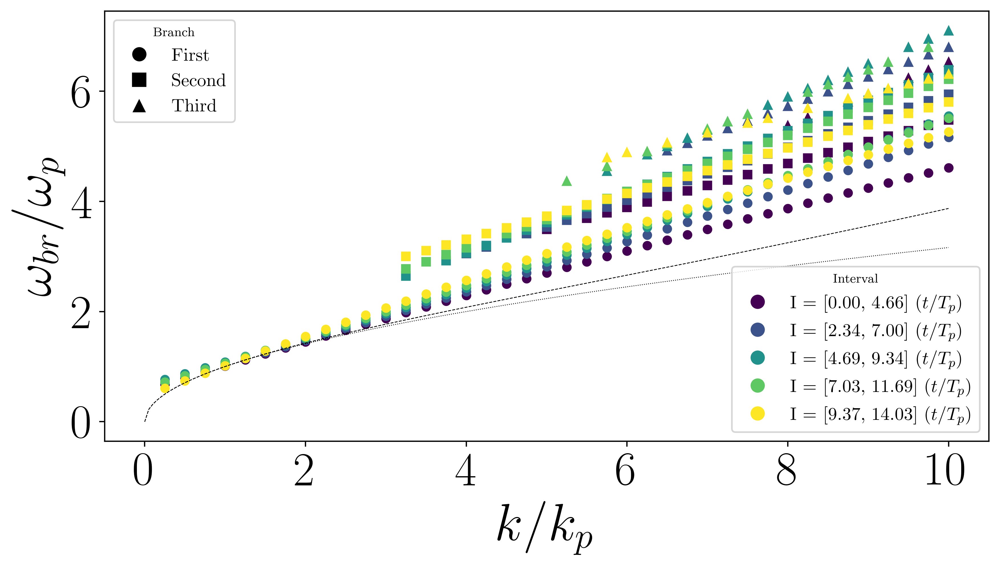

In [14]:
import numpy as np
import matplotlib.pyplot as plt

num_intervals = all_F_komega.shape[0]

## CALCUL SIGMA
rho = 1
sigma = (1 - 1.25 * 10**(-3)) / (200*4**2)

t_values = [2.35, 4.65, 6.96, 9.2]

# Factores de normalización para cada rama
normalization_factors = [np.sqrt(1), np.sqrt(1), np.sqrt(1)]

interval_indices_first = np.array(interval_indices_first, dtype=int)
interval_indices_second = np.array(interval_indices_second, dtype=int)
interval_indices_third = np.array(interval_indices_third, dtype=int)

# Verifica que las longitudes coincidan
assert len(k_values_first) == len(differences_first) == len(interval_indices_first) == len(omega_values_first), "Las longitudes de k_values_first, differences_first e interval_indices_first no coinciden"
assert len(k_values_second) == len(differences_second) == len(interval_indices_second) == len(omega_values_second), "Las longitudes de k_values_second, differences_second e interval_indices_second no coinciden"
assert len(k_values_third) == len(differences_third) == len(interval_indices_third) == len(omega_values_third), "Las longitudes de k_values_third, differences_third e interval_indices_third no coinciden"

# Normalizar las diferencias para cada conjunto
normalized_omega_first = np.abs(np.array(omega_values_first)) / normalization_factors[0]
normalized_omega_second = np.abs(np.array(omega_values_second)) / normalization_factors[1]
normalized_omega_third = np.abs(np.array(omega_values_third)) / normalization_factors[2]

normalized_differences_first = np.abs(np.array(differences_first)) / normalization_factors[0]
normalized_differences_second = np.abs(np.array(differences_second)) / normalization_factors[1]
normalized_differences_third = np.abs(np.array(differences_third)) / normalization_factors[2]

# Definir símbolos para cada conjunto
symbols = ['o', 's', '^']
labels = ['First', 'Second', 'Third']

# Plot de la diferencia acumulada para todos los intervalos
fig, ax = plt.subplots(figsize=(10, 5))
# Colores para cada intervalo usando la paleta viridis
interval_colors = plt.cm.viridis(np.linspace(0, 1, num_intervals))
start_idx = 0

interval_ranges = []
for i in range(num_intervals):
    end_idx = start_idx + ln
    if end_idx > len(time):
        end_idx = len(time)
    time_subdivision = time[start_idx:end_idx]
    interval_ranges.append(f'I = [{(time_subdivision[0] - time[0]) * omegap / (2 * np.pi):.2f}, {(time_subdivision[-1] - time[0]) * omegap / (2 * np.pi):.2f}] $(t/T_{{p}})$')
    start_idx += (ln - overlap)
    if start_idx >= len(time):
        break

         
start_idx = 0
# Graficar los puntos con colores diferentes según el intervalo
for i in range(num_intervals):
    end_idx = start_idx + ln
    if end_idx > len(time):
        end_idx = len(time)
    time_subdivision = time[start_idx:end_idx]
    
    idx_first = interval_indices_first == i
    idx_second = interval_indices_second == i
    idx_third = interval_indices_third == i
    
    #u_doppler = 0.1
    if np.any(idx_first):
        k_first = np.array(k_values_first)[idx_first]
        ax.plot(k_first, (normalized_omega_first[idx_first])   , symbols[0], markersize=5, color=interval_colors[i], label=interval_ranges[i] if i == 0 else "") # k_first **3 *sigma/rho 
    
    if np.any(idx_second):
        k_second = np.array(k_values_second)[idx_second]
        #u_z_second = np.interp(k_second, new_phi[:len(u_z_avg_filtered)], u_z_avg_filtered)
        ax.plot(k_second, (normalized_omega_second[idx_second])  , symbols[1], markersize=5, color=interval_colors[i], label=interval_ranges[i] if i == 0 else "") #k_second **3 *sigma/rho - 
    
    if np.any(idx_third):
        k_third = np.array(k_values_third)[idx_third]
        #u_z_third = np.interp(k_third, new_phi[:len(u_z_avg_filtered)], u_z_avg_filtered)
        ax.plot(k_third, (normalized_omega_third[idx_third] ) , symbols[2], markersize=5, color=interval_colors[i], label=interval_ranges[i] if i == 0 else "") #k_third **3 *sigma/rho 
    
    start_idx += (ln - overlap)
    if start_idx >= len(time):
        break

# Añadir la relación de dispersión teórica para el agua
k_diss = np.linspace(0, 40,200)
dispersion_relation = np.sqrt(k_diss * g)
dispersion_relation_tension = np.sqrt(k_diss * g + sigma/rho * k_diss**3)
ax.plot(k_diss / 4, dispersion_relation / omegap, ':', lw=0.5, c='black', label=r"$\omega= \sqrt{gk}$")
ax.plot(k_diss / 4, dispersion_relation_tension / omegap, '--', lw=0.5, c='black', label=r"$\omega= \sqrt{gk + \sigma/\rho k^3}$")

ax.set_xlabel(r'$k/k_{p}$')
ax.set_ylabel(r'$ \omega_{br} /\omega_{p}$')

# Crear leyendas separadas para las ramas y los intervalos
first_legend = ax.legend([plt.Line2D([0], [0], marker=s, color='w', markerfacecolor='black', markersize=10) for s in symbols], labels, loc='upper left', title='Branch')
ax.add_artist(first_legend)

# Utiliza los rangos de intervalos originales en la leyenda
unique_handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=interval_colors[i], markersize=10) for i in range(num_intervals)]
ax.legend(unique_handles, interval_ranges, loc='lower right', title='Interval')

plt.show()

/tmp/ipykernel_3977300/1876574975.py:66: RuntimeWarning: divide by zero encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:66: RuntimeWarning: invalid value encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:69: RuntimeWarning: divide by zero encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:69: RuntimeWarning: invalid value encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:79: RuntimeWarning: invalid value encountered in sqrt
  omega_disp = (k* g)**0.5


(512, 150) (512, 150) (150, 512)
(512, 150)


/tmp/ipykernel_3977300/1876574975.py:87: UserWarning: Z contains NaN values. This may result in rendering artifacts.
  surf = ax.plot_surface(K/4,   Omega/omegap, Z, cmap='viridis', alpha = 0.6, vmin=vmin, vmax=vmax, rstride=1, cstride=1,linewidth=0, antialiased=False)
/tmp/ipykernel_3977300/1876574975.py:95: RuntimeWarning: invalid value encountered in sqrt
  ax.plot(k / 4, (k * g)**0.5 / omegap, zs=vmin, zdir='z', linestyle='--', linewidth=1.5, color='red', label='Linear Dispersion Relation')
/usr/licensed/anaconda3/2021.11/lib/python3.9/site-packages/mpl_toolkits/mplot3d/proj3d.py:109: RuntimeWarning: invalid value encountered in true_divide
  txs, tys, tzs = vecw[0]/w, vecw[1]/w, vecw[2]/w
/usr/licensed/anaconda3/2021.11/lib/python3.9/site-packages/mpl_toolkits/mplot3d/proj3d.py:109: RuntimeWarning: invalid value encountered in true_divide
  txs, tys, tzs = vecw[0]/w, vecw[1]/w, vecw[2]/w


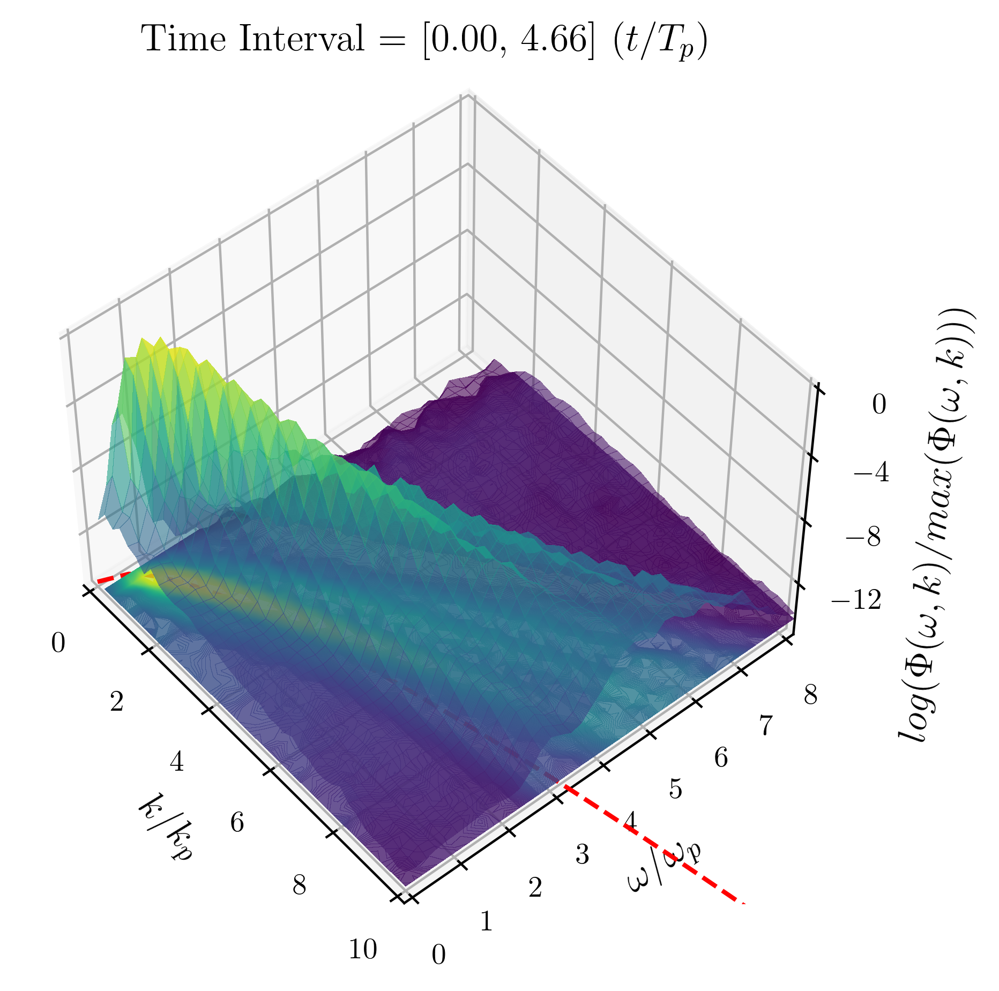

/tmp/ipykernel_3977300/1876574975.py:66: RuntimeWarning: divide by zero encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:66: RuntimeWarning: invalid value encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:69: RuntimeWarning: divide by zero encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:69: RuntimeWarning: invalid value encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:79: RuntimeWarning: invalid value encountered in sqrt
  omega_disp = (k* g)**0.5


(512, 150) (512, 150) (150, 512)
(512, 150)


/tmp/ipykernel_3977300/1876574975.py:87: UserWarning: Z contains NaN values. This may result in rendering artifacts.
  surf = ax.plot_surface(K/4,   Omega/omegap, Z, cmap='viridis', alpha = 0.6, vmin=vmin, vmax=vmax, rstride=1, cstride=1,linewidth=0, antialiased=False)
/tmp/ipykernel_3977300/1876574975.py:95: RuntimeWarning: invalid value encountered in sqrt
  ax.plot(k / 4, (k * g)**0.5 / omegap, zs=vmin, zdir='z', linestyle='--', linewidth=1.5, color='red', label='Linear Dispersion Relation')
/usr/licensed/anaconda3/2021.11/lib/python3.9/site-packages/mpl_toolkits/mplot3d/proj3d.py:109: RuntimeWarning: invalid value encountered in true_divide
  txs, tys, tzs = vecw[0]/w, vecw[1]/w, vecw[2]/w


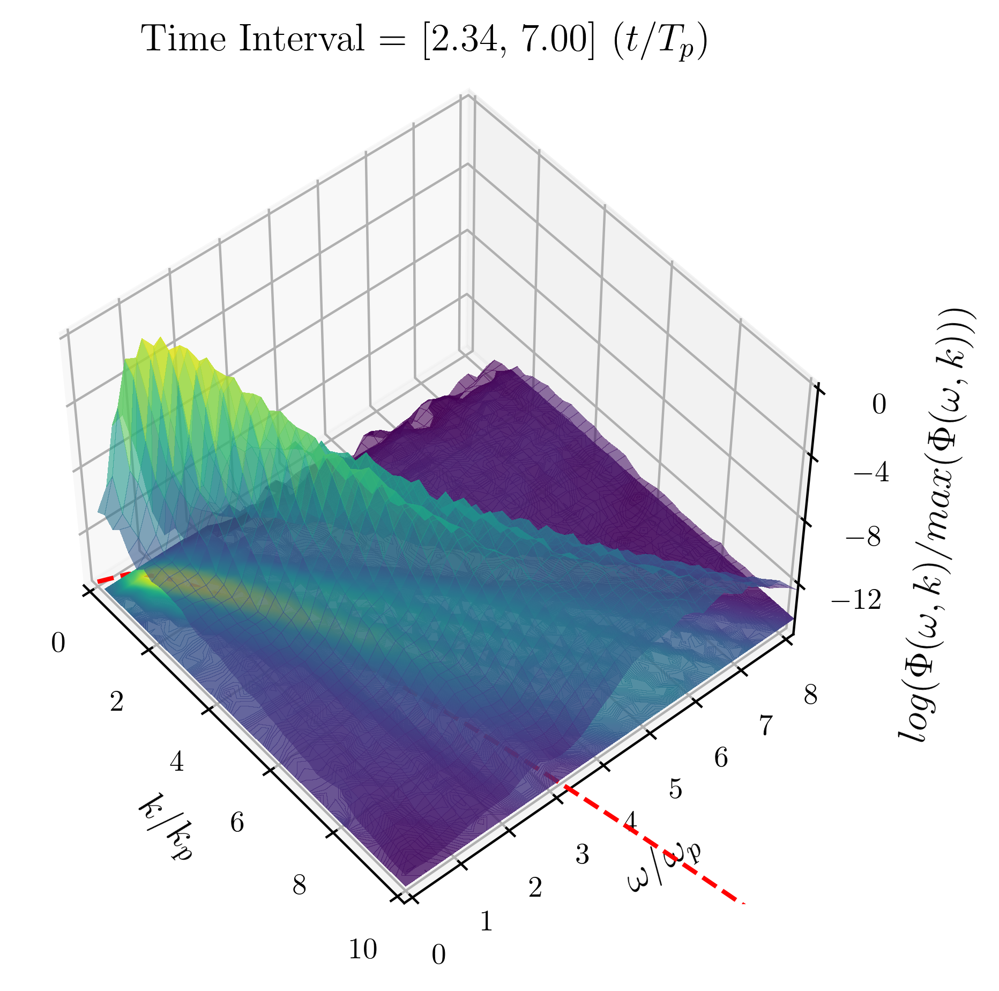

/tmp/ipykernel_3977300/1876574975.py:66: RuntimeWarning: divide by zero encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:66: RuntimeWarning: invalid value encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:69: RuntimeWarning: divide by zero encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:69: RuntimeWarning: invalid value encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:79: RuntimeWarning: invalid value encountered in sqrt
  omega_disp = (k* g)**0.5


(512, 150) (512, 150) (150, 512)
(512, 150)


/tmp/ipykernel_3977300/1876574975.py:87: UserWarning: Z contains NaN values. This may result in rendering artifacts.
  surf = ax.plot_surface(K/4,   Omega/omegap, Z, cmap='viridis', alpha = 0.6, vmin=vmin, vmax=vmax, rstride=1, cstride=1,linewidth=0, antialiased=False)
/tmp/ipykernel_3977300/1876574975.py:95: RuntimeWarning: invalid value encountered in sqrt
  ax.plot(k / 4, (k * g)**0.5 / omegap, zs=vmin, zdir='z', linestyle='--', linewidth=1.5, color='red', label='Linear Dispersion Relation')
/usr/licensed/anaconda3/2021.11/lib/python3.9/site-packages/mpl_toolkits/mplot3d/proj3d.py:109: RuntimeWarning: invalid value encountered in true_divide
  txs, tys, tzs = vecw[0]/w, vecw[1]/w, vecw[2]/w


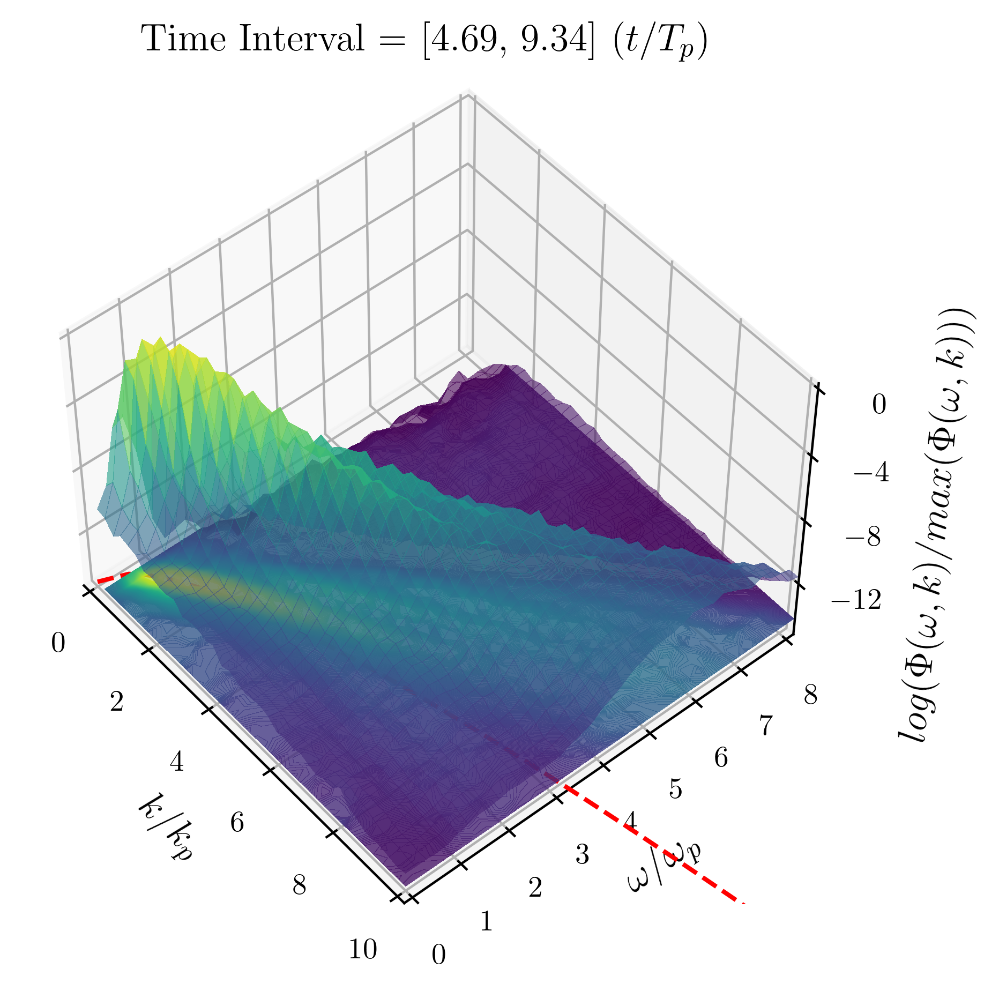

/tmp/ipykernel_3977300/1876574975.py:66: RuntimeWarning: divide by zero encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:66: RuntimeWarning: invalid value encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:69: RuntimeWarning: divide by zero encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:69: RuntimeWarning: invalid value encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:79: RuntimeWarning: invalid value encountered in sqrt
  omega_disp = (k* g)**0.5


(512, 150) (512, 150) (150, 512)
(512, 150)


/tmp/ipykernel_3977300/1876574975.py:87: UserWarning: Z contains NaN values. This may result in rendering artifacts.
  surf = ax.plot_surface(K/4,   Omega/omegap, Z, cmap='viridis', alpha = 0.6, vmin=vmin, vmax=vmax, rstride=1, cstride=1,linewidth=0, antialiased=False)
/tmp/ipykernel_3977300/1876574975.py:95: RuntimeWarning: invalid value encountered in sqrt
  ax.plot(k / 4, (k * g)**0.5 / omegap, zs=vmin, zdir='z', linestyle='--', linewidth=1.5, color='red', label='Linear Dispersion Relation')
/usr/licensed/anaconda3/2021.11/lib/python3.9/site-packages/mpl_toolkits/mplot3d/proj3d.py:109: RuntimeWarning: invalid value encountered in true_divide
  txs, tys, tzs = vecw[0]/w, vecw[1]/w, vecw[2]/w


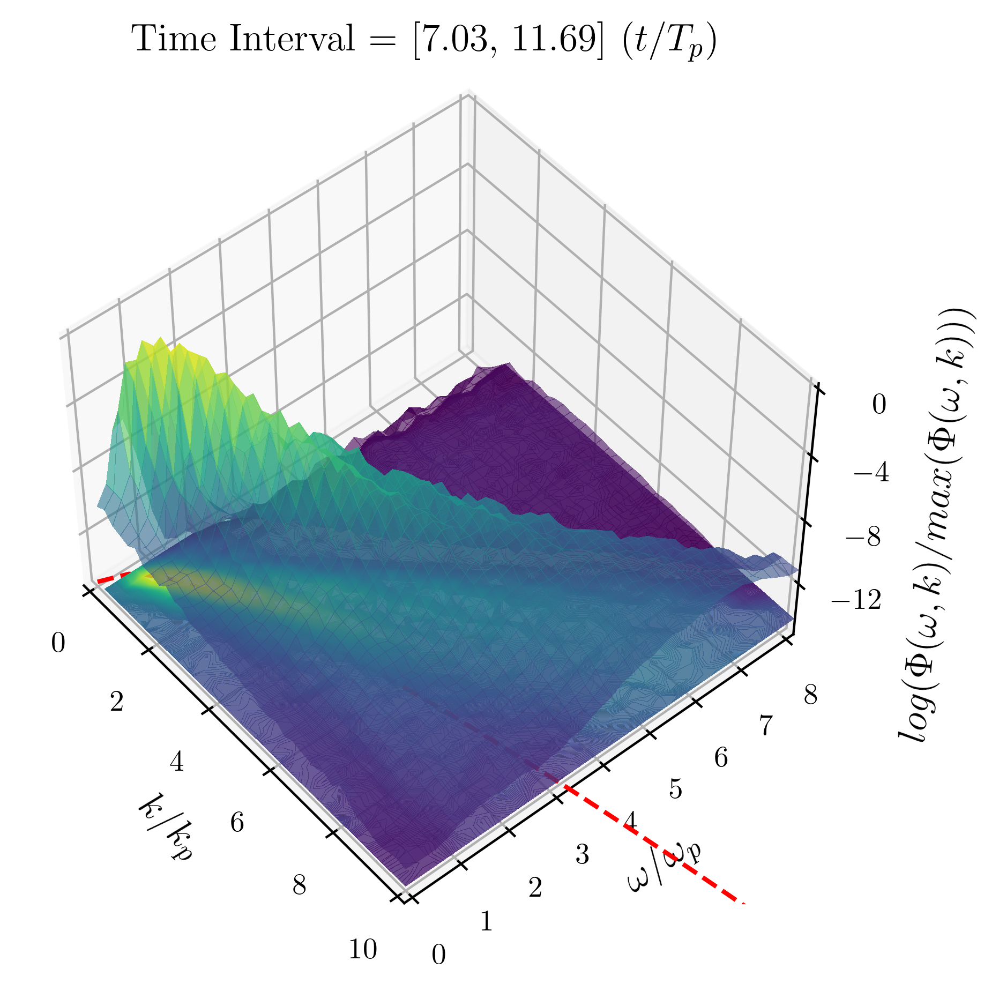

/tmp/ipykernel_3977300/1876574975.py:66: RuntimeWarning: divide by zero encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:66: RuntimeWarning: invalid value encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:69: RuntimeWarning: divide by zero encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:69: RuntimeWarning: invalid value encountered in log
  Z = np.log(all_F_komega[i, :, :] / norm)
/tmp/ipykernel_3977300/1876574975.py:79: RuntimeWarning: invalid value encountered in sqrt
  omega_disp = (k* g)**0.5


(512, 150) (512, 150) (150, 512)
(512, 150)


/tmp/ipykernel_3977300/1876574975.py:87: UserWarning: Z contains NaN values. This may result in rendering artifacts.
  surf = ax.plot_surface(K/4,   Omega/omegap, Z, cmap='viridis', alpha = 0.6, vmin=vmin, vmax=vmax, rstride=1, cstride=1,linewidth=0, antialiased=False)
/tmp/ipykernel_3977300/1876574975.py:95: RuntimeWarning: invalid value encountered in sqrt
  ax.plot(k / 4, (k * g)**0.5 / omegap, zs=vmin, zdir='z', linestyle='--', linewidth=1.5, color='red', label='Linear Dispersion Relation')
/usr/licensed/anaconda3/2021.11/lib/python3.9/site-packages/mpl_toolkits/mplot3d/proj3d.py:109: RuntimeWarning: invalid value encountered in true_divide
  txs, tys, tzs = vecw[0]/w, vecw[1]/w, vecw[2]/w


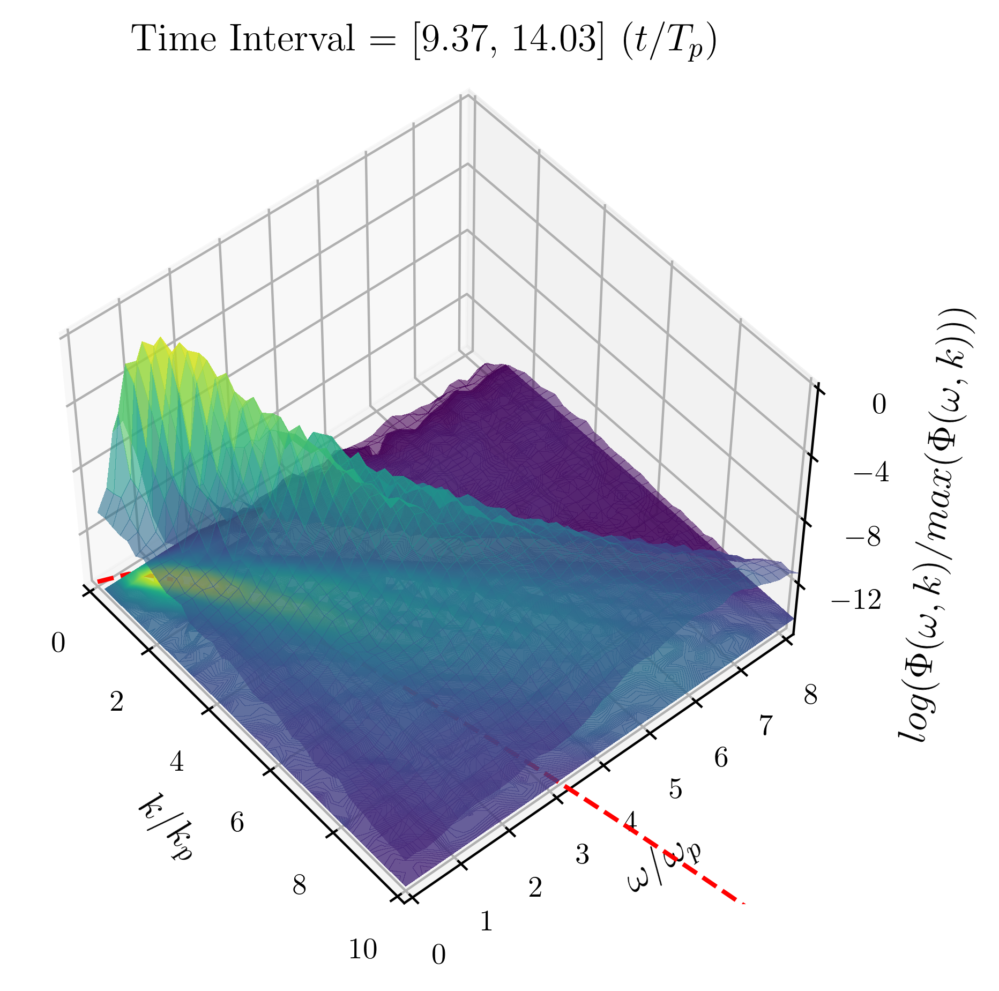

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pylab
import numpy as np
import matplotlib.tri as mtri
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

import scipy.interpolate
params = {'legend.fontsize': 'small',
          'figure.figsize': (12, 6),
          'axes.labelsize': 13,
          'axes.titlesize':13,
          'xtick.labelsize':10,
          'ytick.labelsize':10,
          'font.family': 'STIXGeneral',
          'axes.titleweight': 'normal',
          'axes.labelweight': 'normal',
          'text.usetex': True,
}

pylab.rcParams.update(params)

# Variables definidas según tus datos
Re_water = 2.5 * 10**4
c = 1
nu_water = c * 2 * np.pi / (4 * Re_water)
g = 1
omegap = np.sqrt(g * 4)
all_F_komega = np.array(all_F_komega)
interval_duration = ln * dt
overlap_factor = 0.5
overlap = int(ln * overlap_factor)
start_idx = 0
c = 1/2

# Llamada a la función spectrum3D_subdivisions
#k, omega, k_tile, theta_tile, kx, kx_tile, ky_tile, all_F_xyomega, all_F_komega, Omega = spectrum3D_subdivisions(DataEta, time, ln)

rango_k = (0, 40)
rango_omega = (0, 17)

Omega =   Omega

for i in range(all_F_komega.shape[0]):
    fig = plt.figure(figsize=(10, 5))
    ax = fig.add_subplot(111, projection='3d')
    vmin = -15
    vmax = 0
    levels = np.linspace(vmin, vmax, 300)
    
    end_idx = start_idx + ln
    if end_idx > len(time):
        end_idx = len(time)
    time_subdivision = time[start_idx:end_idx]
    norm = np.max(all_F_komega[i, :, :])

    # Asegurar que las dimensiones coincidan
    #k_tile, omega_tile = np.meshgrid(k, omega)
    #k_tile = k_tile[:all_F_komega[i, :, :].shape[0], :all_F_komega[i, :, :].shape[1]]
    #omega_tile = omega_tile[:all_F_komega[i, :, :].shape[0], :all_F_komega[i, :, :].shape[1]]

    # Manejar valores NaN
    Z = np.log(all_F_komega[i, :, :] / norm)
    Z[np.isnan(Z)] = vmin  # Reemplazar NaN con el valor mínimo
    print(  Omega.shape, K.shape, Z.shape) 
    Z = np.log(all_F_komega[i, :, :] / norm)
    Z = np.where((K >= rango_k[0]) & (K <= rango_k[1]) & (Omega >= rango_omega[0]) & (Omega <= rango_omega[1]), Z.T, np.nan)
    
    print(Z.shape)
    #ax.plot(k/4, (k/4 * g)**0.5 / omegap, zs=-19, zdir='z', linestyle=':', linewidth=0.5, color='w')
    
    #cset_omega0 = ax.contourf(K / 4, Omega / omegap, Z, zdir='y', offset=-1,cmap='viridis')    
    # Agregar la relación de dispersión en la proyección de abajo
    
    
    omega_disp = (k* g)**0.5
    #fig.draw_without_rendering() 
    #ax.plot(k, omega_disp/ omegap, zs=-19.5, zdir='z', linestyle='--', linewidth=1.5, color='red', label='Linear Dispersion Relation')
    ax.contourf(K / 4, Omega / omegap, Z, zdir='z', offset=vmin, alpha=0.8, cmap='viridis', levels=levels)
    #ax.contourf(K / 4, Z, Omega / omegap , zdir='y', offset=8, alpha=0.8, cmap='viridis', levels=levels)
    #ax.contourf(Z, Omega / omegap , K / 4, zdir='x', alpha=0.8, cmap='viridis', levels=levels)
    

    surf = ax.plot_surface(K/4,   Omega/omegap, Z, cmap='viridis', alpha = 0.6, vmin=vmin, vmax=vmax, rstride=1, cstride=1,linewidth=0, antialiased=False)

    
    vel1 = np.sqrt(nu_water * ((time_subdivision[-1] - time[0]) - (time_subdivision[0] - time[0])))
    vel4 = np.sqrt(4 * nu_water * ((time_subdivision[-1] - time[0]) - (time_subdivision[0] - time[0])))
    vel8 = np.sqrt(8 * nu_water * ((time_subdivision[-1] - time[0]) - (time_subdivision[0] - time[0])))

    
    ax.plot(k / 4, (k * g)**0.5 / omegap, zs=vmin, zdir='z', linestyle='--', linewidth=1.5, color='red', label='Linear Dispersion Relation')
    #ax.plot(k, (k * g)**0.5 / omegap + vel1 * k, zs=vmin, zdir='z', linestyle=':', linewidth=0.5, color='yellow')
    #ax.plot(k, (2.5 * k * g)**0.5 / omegap, zs=vmin, zdir='z', linestyle=':', linewidth=0.5, color='yellow')
    #ax.plot(k, (3 * k * g)**0.5 / omegap, zs=vmin, zdir='z', linestyle=':', linewidth=0.5, color='yellow')
    ax.view_init(elev=50, azim=-40)  # Ajustar elevación y ángulo de azimut para ver más desde arriba

    ax.set_xlim([0, 10])
    ax.set_ylim([0, 8])
    ax.set_zlim([vmin, vmax])
    
    ax.set_xlabel(r'$k/k_{p}$')
    ax.set_ylabel(r'$\omega/\omega_{p}$')
    ax.set_zlabel(r'$log(\Phi(\omega,k)/max(\Phi(\omega,k)))$')
    ax.zaxis.set_major_locator(plt.MaxNLocator(4))

    ax.set_title(f'Time Interval = [{(time_subdivision[0]-time[0])*omegap/(2*np.pi):.2f}, '
                 f'{(time_subdivision[-1]-time[0])*omegap/(2*np.pi):.2f}] $(t/T_{{p}})$', pad=15)

    plt.show()

    start_idx += (ln - overlap)
    if start_idx >= len(time):
        break


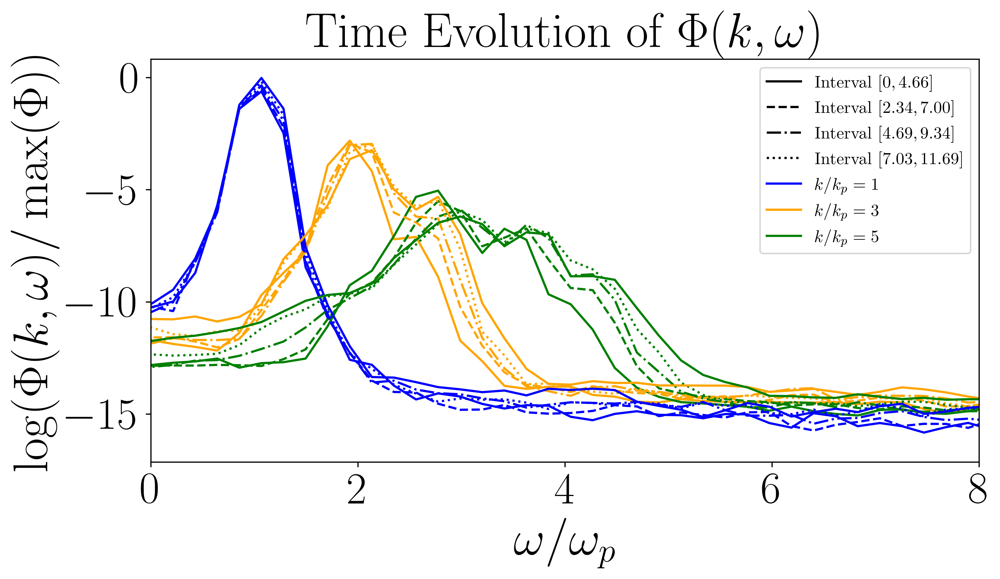

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize

# Configuración de visualización
params = {
    'legend.fontsize': 'x-large',
    'figure.figsize': (14, 6),
    'axes.labelsize': 33,
    'axes.titlesize': 33,
    'xtick.labelsize': 30,
    'ytick.labelsize': 30,
    'font.family': 'STIXGeneral',  # Usar 'Comic Sans MS' o 'Helvetica' según necesidad
    'axes.titleweight': 'normal',
    'axes.labelweight': 'normal',
    'text.usetex': True  # Habilitar renderizado LaTeX
}

plt.rcParams.update(params)

# Definir valores de 'k' que te interesan y colores
indices_k = [4, 12, 20]  # Asegúrate de que estos índices sean correctos para tus datos
colors = ['blue', 'orange', 'green']  # Colores para los gráficos
line_styles = ['-', '--', '-.', ':']  # Estilos de línea para cada intervalo de tiempo

# Crear una figura y un eje
fig, ax = plt.subplots(figsize=(10, 5))

# Bucle a través de cada intervalo de tiempo
for time_idx in range(all_F_komega.shape[0]):
    for idx, k_idx in enumerate(indices_k):
        # Asumiendo que 'omega' y 'omegap' están definidos correctamente
        omega_normalized = omega / omegap
        data_normalized = np.log(all_F_komega[time_idx, :, k_idx] / np.max(all_F_komega[:, :, :]))
        
        # Añadir cada línea al gráfico con un estilo de línea diferente por intervalo de tiempo
        ax.plot(omega_normalized, data_normalized, color=colors[idx], linestyle=line_styles[time_idx % len(line_styles)])
        #label=f'Time {time_idx+1}, $k/k_p = {k_idx/kp:.2f}$',color=colors[idx], linestyle=line_styles[time_idx % len(line_styles)])

# Configurar gráfico
ax.set_xlim([0, 8])
ax.set_title('Time Evolution of $\Phi(k, \omega)$')
ax.set_xlabel(r'$\omega/\omega_p$')
ax.set_ylabel(r'$\log(\Phi(k,\omega) / \max(\Phi))$')

plt.plot([], [], '-', c = 'k', label = 'Interval $[0,4.66]$')
plt.plot([], [], '--', c = 'k', label = 'Interval $[2.34,7.00]$')
plt.plot([], [], '-.', c = 'k', label = 'Interval $[4.69,9.34]$')
plt.plot([], [], ':', c = 'k', label = 'Interval $[7.03,11.69]$')
plt.plot([], [], '-', c = 'b', label = '$k/k_{{p}}=1$')
plt.plot([], [], '-', c = 'orange', label = '$k/k_{{p}}=3$')
plt.plot([], [], '-', c = 'green', label = '$k/k_{{p}}=5$')
ax.legend()

# Mostrar el gráfico
plt.show()